In [1]:
import warnings

warnings.filterwarnings("ignore")
import json
import math
import os
from urllib.parse import urlparse

import geopandas as gpd
import libpysal as ps
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.graph_objs as go
import pysal
import seaborn as sns
import statsmodels.api as sm
from esda.moran import Moran, Moran_Local
from libpysal.weights import Queen
from matplotlib import image as mpimg
from mgwr.gwr import GWR, MGWR
from mgwr.sel_bw import Sel_BW
from requests import get
from splot.esda import lisa_cluster
from spreg import GM_Error_Het

In [2]:
# Function to download file from remote
# Adapted from CASA0013


def cache_data(src: str, dest: str) -> str:
    """
    Create a folder to store file from URL.
    If folder doesn't already exists, then create one, before writing the file.

    src : URL
    dest : location on local drive
    """
    url = urlparse(src)  # We assume that this is some kind of valid URL
    fn = os.path.split(url.path)[-1]  # Extract the filename
    dfn = os.path.join(dest, fn)  # Destination filename as path

    if not os.path.isfile(dfn):
        print(f"{dfn} not found, downloading!")
        path = os.path.split(dest)
        if len(path) >= 1 and path[0] != "":
            os.makedirs(os.path.join(*path), exist_ok=True)
        with open(dfn, "wb") as file:
            response = get(src)
            file.write(response.content)
        print("\tDone downloading...")
    else:
        print(f"Found {dfn} locally!")
    return dfn

In [3]:
# Function to create bivariate chropleth map
# Adapted from: https://www.kaggle.com/code/yotkadata/bivariate-choropleth-map-using-plotly
"""
Function to set default variables
"""


def conf_defaults():
    # Define some variables for later use
    conf = {
        "plot_title": "Bivariate choropleth map using Ploty",  # Title text
        "plot_title_size": 20,  # Font size of the title
        "width": 1000,  # Width of the final map container
        "ratio": 0.8,  # Ratio of height to width
        "center_lat": 0,  # Latitude of the center of the map
        "center_lon": 0,  # Longitude of the center of the map
        "map_zoom": 3,  # Zoom factor of the map
        "hover_x_label": "Label x variable",  # Label to appear on hover
        "hover_y_label": "Label y variable",  # Label to appear on hover
        "borders_width": 0.5,  # Width of the geographic entity borders
        "borders_color": "#f8f8f8",  # Color of the geographic entity borders
        # Define settings for the legend
        "top": 1,  # Vertical position of the top right corner (0: bottom, 1: top)
        "right": 1,  # Horizontal position of the top right corner (0: left, 1: right)
        "box_w": 0.04,  # Width of each rectangle
        "box_h": 0.04,  # Height of each rectangle
        "line_color": "#f8f8f8",  # Color of the rectagles' borders
        "line_width": 0,  # Width of the rectagles' borders
        "legend_x_label": "Higher x value",  # x variable label for the legend
        "legend_y_label": "Higher y value",  # y variable label for the legend
        "legend_font_size": 9,  # Legend font size
        "legend_font_color": "#333",  # Legend font color
    }
    # Calculate height
    conf["height"] = conf["width"] * conf["ratio"]

    return conf


"""
Function to recalculate values in case width is changed
"""


def recalc_vars(new_width, variables, conf=conf_defaults()):
    # Calculate the factor of the changed width
    factor = new_width / 1000

    # Apply factor to all variables that have been passed to the function
    for var in variables:
        if var == "map_zoom":
            # Calculate the zoom factor
            # Mapbox zoom is based on a log scale. map_zoom needs to be set
            # to value ideal for our map at 1000px.
            # So factor = 2 ^ (zoom - map_zoom) and zoom = log(factor) / log(2) + map_zoom
            conf[var] = math.log(factor) / math.log(2) + conf[var]
        else:
            conf[var] = conf[var] * factor

    return conf


"""
Function that assigns a value (x) to one of three bins (0, 1, 2).
The break points for the bins can be defined by break_1 and break_2.
"""


def set_interval_value(x, break_1, break_2):
    if x <= break_1:
        return 0
    elif break_1 < x <= break_2:
        return 1
    else:
        return 2


"""
Function that adds a column 'biv_bins' to the dataframe containing the 
position in the 9-color matrix for the bivariate colors
    
Arguments:
    df: Dataframe
    x: Name of the column containing values of the first variable
    y: Name of the column containing values of the second variable

"""


def prepare_df(df, x="x", y="y"):
    # Check if arguments match all requirements
    if df[x].shape[0] != df[y].shape[0]:
        raise ValueError(
            "ERROR: The list of x and y coordinates must have the same length."
        )

    # Calculate break points at percentiles 33 and 66
    x_breaks = np.percentile(df[x], [33, 66])
    y_breaks = np.percentile(df[y], [33, 66])

    # Assign values of both variables to one of three bins (0, 1, 2)
    x_bins = [
        set_interval_value(value_x, x_breaks[0], x_breaks[1]) for value_x in df[x]
    ]
    y_bins = [
        set_interval_value(value_y, y_breaks[0], y_breaks[1]) for value_y in df[y]
    ]

    # Calculate the position of each x/y value pair in the 9-color matrix of bivariate colors
    df["biv_bins"] = [
        int(value_x + 3 * value_y) for value_x, value_y in zip(x_bins, y_bins)
    ]

    return df


"""
Function to create a color square containig the 9 colors to be used as a legend
"""


def create_legend(fig, colors, conf=conf_defaults()):
    # Reverse the order of colors
    legend_colors = colors[:]
    legend_colors.reverse()

    # Calculate coordinates for all nine rectangles
    coord = []

    # Adapt height to ratio to get squares
    width = conf["box_w"]
    height = conf["box_h"] / conf["ratio"]

    # Start looping through rows and columns to calculate corners the squares
    for row in range(1, 4):
        for col in range(1, 4):
            coord.append(
                {
                    "x0": round(conf["right"] - (col - 1) * width, 4),
                    "y0": round(conf["top"] - (row - 1) * height, 4),
                    "x1": round(conf["right"] - col * width, 4),
                    "y1": round(conf["top"] - row * height, 4),
                }
            )

    # Create shapes (rectangles)
    for i, value in enumerate(coord):
        # Add rectangle
        fig.add_shape(
            go.layout.Shape(
                type="rect",
                fillcolor=legend_colors[i],
                line=dict(
                    color=conf["line_color"],
                    width=conf["line_width"],
                ),
                xref="paper",
                yref="paper",
                xanchor="right",
                yanchor="top",
                x0=coord[i]["x0"],
                y0=coord[i]["y0"],
                x1=coord[i]["x1"],
                y1=coord[i]["y1"],
            )
        )

        # Add text for first variable
        fig.add_annotation(
            xref="paper",
            yref="paper",
            xanchor="left",
            yanchor="top",
            x=coord[8]["x1"],
            y=coord[8]["y1"],
            showarrow=False,
            text=conf["legend_x_label"] + " 🠒",
            font=dict(
                color=conf["legend_font_color"],
                size=conf["legend_font_size"],
            ),
            borderpad=0,
        )

        # Add text for second variable
        fig.add_annotation(
            xref="paper",
            yref="paper",
            xanchor="right",
            yanchor="bottom",
            x=coord[8]["x1"],
            y=coord[8]["y1"],
            showarrow=False,
            text=conf["legend_y_label"] + " 🠒",
            font=dict(
                color=conf["legend_font_color"],
                size=conf["legend_font_size"],
            ),
            textangle=270,
            borderpad=0,
        )

    return fig


"""
Function to create the map

Arguments:
    df: The dataframe that contains all the necessary columns
    colors: List of 9 blended colors
    x: Name of the column that contains values of first variable (defaults to 'x')
    y: Name of the column that contains values of second variable (defaults to 'y')
    ids: Name of the column that contains ids that connect the data to the GeoJSON (defaults to 'id')
    name: Name of the column conatining the geographic entity to be displayed as a description (defaults to 'name')
"""


def create_bivariate_map(
    df, colors, geojson, x="x", y="y", ids="id", name="name", conf=conf_defaults()
):
    if len(colors) != 9:
        raise ValueError(
            "ERROR: The list of bivariate colors must have a length eaqual to 9."
        )

    # Recalculate values if width differs from default
    if not conf["width"] == 1000:
        conf = recalc_vars(
            conf["width"],
            ["height", "plot_title_size", "legend_font_size", "map_zoom"],
            conf,
        )

    # Prepare the dataframe with the necessary information for our bivariate map
    df_plot = prepare_df(df, x, y)

    # Create the figure
    fig = go.Figure(
        go.Choroplethmapbox(
            geojson=geojson,
            locations=df_plot[ids],
            z=df_plot["biv_bins"],
            marker_line_width=0.5,
            colorscale=[
                [0 / 8, colors[0]],
                [1 / 8, colors[1]],
                [2 / 8, colors[2]],
                [3 / 8, colors[3]],
                [4 / 8, colors[4]],
                [5 / 8, colors[5]],
                [6 / 8, colors[6]],
                [7 / 8, colors[7]],
                [8 / 8, colors[8]],
            ],
            customdata=df_plot[
                [name, ids, x, y]
            ],  # Add data to be used in hovertemplate
            hovertemplate="<br>".join(
                [  # Data to be displayed on hover
                    "<b>%{customdata[0]}</b> (ID: %{customdata[1]})",
                    conf["hover_x_label"] + ": %{customdata[2]}",
                    conf["hover_y_label"] + ": %{customdata[3]}",
                    "<extra></extra>",  # Remove secondary information
                ]
            ),
        )
    )

    # Add some more details
    fig.update_layout(
        title=dict(
            text=conf["plot_title"],
            font=dict(
                size=conf["plot_title_size"],
            ),
        ),
        mapbox_style="white-bg",
        width=conf["width"],
        height=conf["height"],
        autosize=True,
        mapbox=dict(
            center=dict(
                lat=conf["center_lat"], lon=conf["center_lon"]
            ),  # Set map center
            zoom=conf["map_zoom"],  # Set zoom
        ),
    )

    fig.update_traces(
        marker_line_width=conf[
            "borders_width"
        ],  # Width of the geographic entity borders
        marker_line_color=conf[
            "borders_color"
        ],  # Color of the geographic entity borders
        showscale=False,  # Hide the colorscale
    )

    # Add the legend
    fig = create_legend(fig, colors, conf)

    return fig


# Define sets of 9 colors to be used
# Order: bottom-left, bottom-center, bottom-right, center-left, center-center, center-right, top-left, top-center, top-right
color_sets = {
    "pink-blue": [
        "#e8e8e8",
        "#ace4e4",
        "#5ac8c8",
        "#dfb0d6",
        "#a5add3",
        "#5698b9",
        "#be64ac",
        "#8c62aa",
        "#3b4994",
    ],
    "teal-red": [
        "#e8e8e8",
        "#e4acac",
        "#c85a5a",
        "#b0d5df",
        "#ad9ea5",
        "#985356",
        "#64acbe",
        "#627f8c",
        "#574249",
    ],
    "blue-orange": [
        "#fef1e4",
        "#fab186",
        "#f3742d",
        "#97d0e7",
        "#b0988c",
        "#ab5f37",
        "#18aee5",
        "#407b8f",
        "#5c473d",
    ],
}

In [4]:
# calculating VIF
# This function is adjusted from: https://stackoverflow.com/a/51329496/4667568
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant


def drop_column_using_vif_(df, thresh=5):
    """
    Calculates VIF each feature in a pandas dataframe, and repeatedly drop the columns with the highest VIF
    A constant must be added to variance_inflation_factor or the results will be incorrect

    :param df: the pandas dataframe containing only the predictor features, not the response variable
    :param thresh: (default 5) the threshould VIF value. If the VIF of a variable is greater than thresh, it should be removed from the dataframe
    :return: dataframe with multicollinear features removed
    """
    while True:
        # adding a constatnt item to the data. add_constant is a function from statsmodels (see the import above)
        df_with_const = add_constant(df)

        vif_df = pd.Series(
            [
                variance_inflation_factor(df_with_const.values, i)
                for i in range(df_with_const.shape[1])
            ],
            name="VIF",
            index=df_with_const.columns,
        ).to_frame()

        # drop the const
        vif_df = vif_df.drop("const")

        # if the largest VIF is above the thresh, remove a variable with the largest VIF
        # If there are multiple variabels with VIF>thresh, only one of them is removed. This is because we want to keep as many variables as possible
        if vif_df.VIF.max() > thresh:
            # If there are multiple variables with the maximum VIF, choose the first one
            index_to_drop = vif_df.index[vif_df.VIF == vif_df.VIF.max()].tolist()[0]
            print("Dropping: {}".format(index_to_drop))
            df = df.drop(columns=index_to_drop)
        else:
            # No VIF is above threshold. Exit the loop
            break

    return df

In [5]:
# Define paths for download
ddir = os.path.join("data", "geo")  # destination directory
spath = "https://github.com/jreades/i2p/blob/master/data/src/"  # source path
spath_db = "https://www.dropbox.com/scl/fi/"  # source path for dropbox
host = "http://orca.casa.ucl.ac.uk"
path = "~jreades/data"

In [6]:
#| output: false

# Read in airbnb, crime, and lsoa stats files. https://www.dropbox.com/home/casa/casa_fsds_cheers.
# Some files have been cleaned, cropped, turned into gdf and hosted on dropbox to save time later on. See cleandata.ipynb in the Github repo for more details on how these files were created.
# # [PATIENCE] Takes about 4 minutes to download and read in the data

# Crime data filtered for September 2023, within Greater London
crime = gpd.read_file(
    cache_data(
        spath_db
        + "ewc9skqcfr930whzcjadd/crime.gpkg?rlkey=xjve2mmmmt5h3allsa2zpabya&dl=1",
        ddir,
    ),
    driver="gpkg",
    low_memory=False,
)

# Airbnb listing data scraped on September 2023, filtered within Greater London
listings = gpd.read_parquet(
    cache_data(f"{host}/{path}/2023-09-06-listings.geoparquet", ddir)
)
listings = listings.to_crs(epsg=27700)

# LSOA (London) data concatenated from multiple datasets from London Datastore,
lsoa_stat = pd.read_csv(
    cache_data(
        spath_db
        + "8zc0g09rlf1yhj6j7yn6n/lsoa_full.csv?rlkey=yopr4hv017rr3iv4e2zus0ifz&dl=1",
        ddir,
    ),
    low_memory=False,
)

Found data/geo/crime.gpkg locally!
Found data/geo/2023-09-06-listings.geoparquet locally!
Found data/geo/lsoa_full.csv locally!


In [7]:
#| output: false

# Read in shapefiles (2 mins)
water = gpd.read_file(cache_data(spath + "Water.gpkg?raw=true", ddir))
green = gpd.read_file(cache_data(spath + "Greenspace.gpkg?raw=true", ddir))
boros = gpd.read_file(cache_data(spath + "Boroughs.gpkg?raw=true", ddir))
lsoa = gpd.read_file(
    cache_data(
        spath_db
        + "u367zlorie8vuluugy2fr/lsoa_london.gpkg?rlkey=rc7rdnlfdmzfgy5q7ujz9pnwj&dl=1",
        ddir,
    )
)

Found data/geo/Water.gpkg locally!
Found data/geo/Greenspace.gpkg locally!
Found data/geo/Boroughs.gpkg locally!
Found data/geo/lsoa_london.gpkg locally!


In [8]:
#| output: false

# Check that all geo dataframes that they are in EPSG:27700
crs = []
for n in [water, green, boros, lsoa, crime, listings]:
    crs.append(n.crs)
print(f"Geo dataframes are in {set(crs)}")

Geo dataframes are in {<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich
}


#### Background and research question
As a short-term rental platform, the mobility of tenants is one of its major characteristics. Mobility is a factor in crime (Mburu and Helbich, 2016), so recently there has been increasing concern about whether Airbnb, which brings high mobility to the local community, could be linked to an increase or decrease in crime. For example, Xu, Pennington-Gray and Kim (2019) studied the relationship between Airbnb density and crime in Florida and found that certain types of listings do have a significant impact on crime. Therefore, we try to explore whether Airbnb in London could also have an impact on crime based on Lower Layer Super Output Areas (LSOAs) level. The reason why we choose LSOA level as this allows for a more detailed examination of localized patterns and variations within a borough. Different neighborhoods within a borough can exhibit distinct characteristics that might be overlooked in a broader borough-level analysis as crime rates and housing patterns can vary significantly from one neighborhood to another. 

In short, our research question is: Does the type of Airbnb listing have an impact on crime in the neighbourhood? 

#### Data source
The Airbnb dataset is from the September 2023 updated version provided by Inside Airbnb. The crime dataset is from data.police.uk and has the same time dimension as Airbnb’s. The spatial partitioning dimension in this study is LSOA and is from the Office of National Statistics website. In order to examine the nature of short-lets and crime relationship, we want to first establish the parameters to focus on just a subset. As Xu, Pennington-Gray, and Kim (2019) mentioned different types of short-lets have different impacts, we refer to their classification standards defining them as follows (*Data Dictionary*, nd):  
- _Entire home:_ Tenants can enjoy an entire whole listing.  
- _Private room:_ The tenant has a private bedroom but may need to share some space with others such as the kitchen.  

We **excluded Hotel rooms** (listings by actual hotels and hostels) since they are not the subject of this research and are also few in numbers. We also **exclude Shared rooms** due to thier limited number in London. Lastly, we trimmed listing price outliers to filter out bogus listings. Figure 1 shows the listing price distribution of different room types before filtering.

In [9]:
# Transform price to float
if listings.price.dtype == "O":
    listings.price = (
        listings.price.str.replace("$", "").str.replace(",", "").astype(float).round(2)
    )
# Trim outliers in terms of price based on interquartile range, because they are most likely they are not real listings
q1 = listings.price.quantile(0.25)
q3 = listings.price.quantile(0.75)
iqr = q3 - q1
listings1 = listings[
    (listings.price >= q1 - 1.5 * iqr) & (listings.price <= q3 + 1.5 * iqr)
]

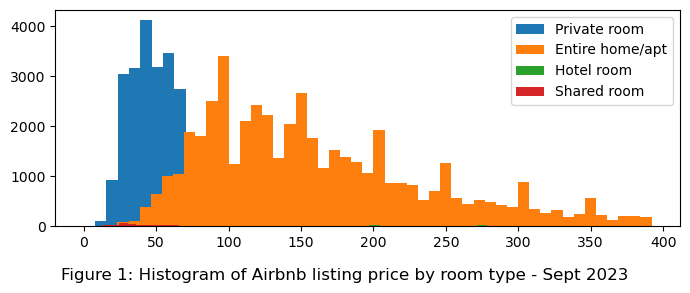

In [10]:
# Plot by room type
room = listings.room_type.unique()
palette = sns.color_palette()

fig, ax1 = plt.subplots(figsize=(7, 3))
for color, r in zip(palette, room):
    ax1.hist(
        listings1[listings1["room_type"] == r].price,
        bins=50,
        alpha=1,
        label=r,
        color=color,
    )
ax1.legend(loc="upper right")
fig.suptitle(
    "Figure 1: Histogram of Airbnb listing price by room type - Sept 2023",
    x=0.5,
    y=-0.01,
)
plt.tight_layout()
plt.show()

In [11]:
# Clean listings data: outliers, and missing values, split into 2 types by property type
# Omit Hotel rooms and Shared rooms
listings2 = listings1[~listings1["room_type"].isin(["Hotel room", "Shared room"])]

In [12]:
# Write it back to original dataframe
listings = listings2.copy()

As for crime data, as we wanted to make recommendations more specific to different categories of crime, we classified crime into the following types (Xu, Pennington-Gray and Kim, 2019; Flatley, 2016):
- **Public order:** public order, drugs, possession of weapons, anti-social behaviour.
- **Violent (involve force):** robbery, violence and sexual offences.
- **Property (without force):** bicycle theft, burglary, criminal damage and arson, shoplifting, theft from the person, vehicle crime..

These three types of crime will be treated as dependent variables. Figure 2 shows the distribution of crime density per LSOA by type. Note that they take on a skewed distribution (Poisson distribution) for being based on count. We will treat this accordingly in our analysis while also not trimming any outlying values at this stage.

In [13]:
# Clean crime data: outliers, and missing values, split into 3 types
crime_property = [
    "Burglary",
    "Criminal damage and arson",
    "Theft from the person",
    "Vehicle crime",
    "Shoplifting",
    "Bicycle theft",
]
crime_violent = ["Robbery", "Violence and sexual offences"]
crime_publicorder = [
    "Anti-social behaviour",
    "Public order",
    "Drugs",
    "Possession of weapons",
]
# Omit rows with Other Crime and Other Theft
crime = crime[~crime["Crime type"].isin(["Other theft", "Other crime"])]
# Create a new column for crime type
crime["Category"] = np.where(
    crime["Crime type"].isin(crime_property),
    "Property crime",
    np.where(
        crime["Crime type"].isin(crime_violent), "Violent crime", "Public Order crime"
    ),
)

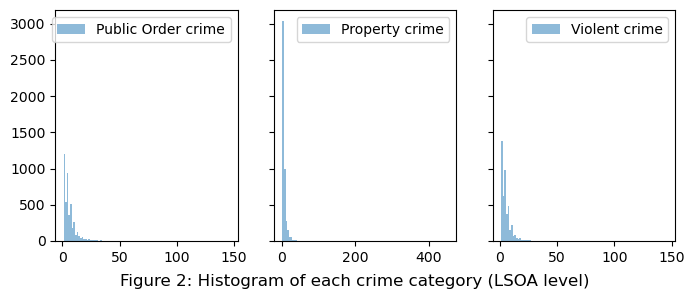

In [14]:
# Plot them
fig, ax = plt.subplots(1, 3, figsize=[8, 3], sharey=True)
for idx, r in enumerate(crime.Category.unique()):
    ax[idx].hist(
        crime[crime["Category"] == r].groupby("LSOA code").count().Category,
        bins=100,
        alpha=0.5,
        label=r,
    )
    ax[idx].legend(loc="upper right")
fig.suptitle("Figure 2: Histogram of each crime category (LSOA level)", x=0.5, y=0)
plt.show()

#### Relationship between Airbnb listings and crime

In [15]:
lsoa_merge = lsoa.copy()

# Spatial crime and lsoa, summarise by count
sjoin_lsoa = gpd.sjoin(crime, lsoa_merge)
count_dict = (
    sjoin_lsoa["LSOA21CD"].value_counts().to_dict()
)  # count the values with value counts
lsoa_merge["crime_count"] = lsoa_merge["LSOA21CD"].map(
    count_dict
)  # map it back to lsoa

# Spatial join listings and lsoa, summarise by count
sjoin_lsoa = gpd.sjoin(listings, lsoa_merge)
count_dict = (
    sjoin_lsoa["LSOA21CD"].value_counts().to_dict()
)  # count the values with value counts
lsoa_merge["listing_count"] = lsoa_merge["LSOA21CD"].map(
    count_dict
)  # map it back to lsoa

In [16]:
# Spatial join crime by categories and lsoa, summarise by count
for s in ["Public Order crime", "Property crime", "Violent crime"]:
    sjoin_lsoa = gpd.sjoin(crime[crime["Category"] == s], lsoa_merge)
    count_dict = (
        sjoin_lsoa["LSOA21CD"].value_counts().to_dict()
    )  # count the values with value counts
    lsoa_merge[s + "_count"] = lsoa_merge["LSOA21CD"].map(
        count_dict
    )  # map it back to lsoa_merge

# Spatial join listings by room type and lsoa, summarise by count
for r in ["Private room", "Entire home/apt"]:
    sjoin_lsoa = gpd.sjoin(listings[listings["room_type"] == r], lsoa_merge)
    count_dict = (
        sjoin_lsoa["LSOA21CD"].value_counts().to_dict()
    )  # count the values with value counts
    lsoa_merge[r + "_count"] = lsoa_merge["LSOA21CD"].map(
        count_dict
    )  # map it back to lsoa_merge

# Change NA to 0
lsoa_merge = lsoa_merge.fillna(0)

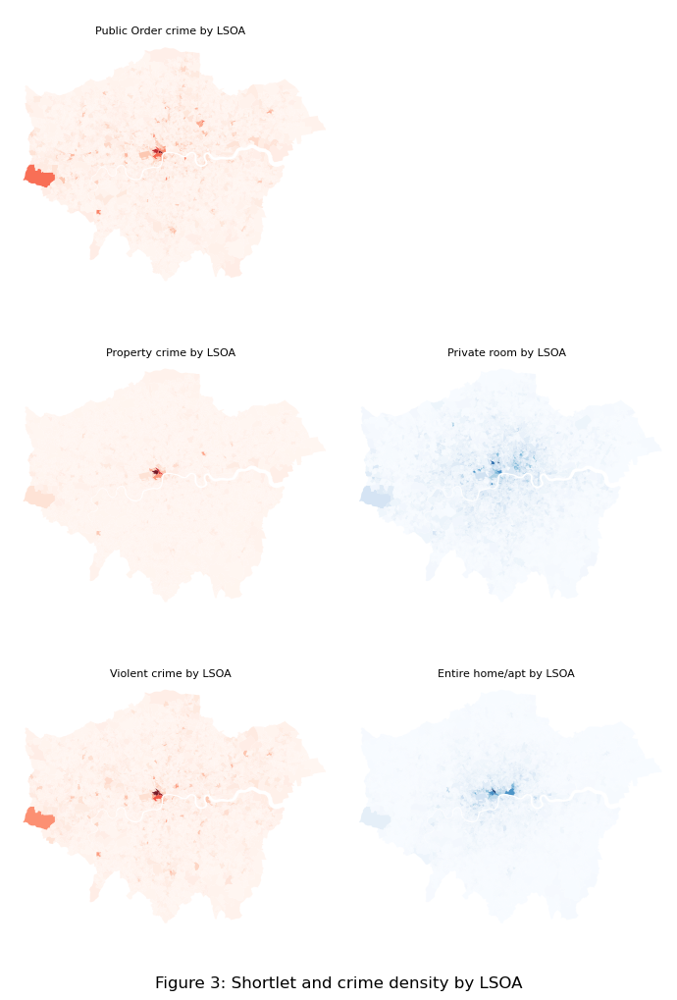

In [17]:
# Plot crime / listings by type
fig, axes = plt.subplots(3, 2, figsize=(7, 10))

lsoa_merge.plot(
    ax=axes[0, 0], column="Public Order crime_count", cmap="Reds", alpha=0.9
)
lsoa_merge.plot(ax=axes[1, 0], column="Property crime_count", cmap="Reds", alpha=0.9)
lsoa_merge.plot(ax=axes[2, 0], column="Violent crime_count", cmap="Reds", alpha=0.9)

axes[0, 0].set_title("Public Order crime by LSOA", fontsize=8)
axes[1, 0].set_title("Property crime by LSOA", fontsize=8)
axes[2, 0].set_title("Violent crime by LSOA", fontsize=8)

axes[0, 1].axis("off")
lsoa_merge.plot(ax=axes[1, 1], column="Private room_count", cmap="Blues", alpha=0.9)
lsoa_merge.plot(ax=axes[2, 1], column="Entire home/apt_count", cmap="Blues", alpha=0.9)

axes[1, 1].set_title("Private room by LSOA", fontsize=8)
axes[2, 1].set_title("Entire home/apt by LSOA", fontsize=8)

for ax in fig.get_axes():
    ax.axis("off")
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    ax.set_xlim([501000, 563000])
    ax.set_ylim([155000, 202000])

plt.tight_layout()
fig.suptitle("Figure 3: Shortlet and crime density by LSOA", x=0.5, y=0)
plt.show()

##### 1. Spatial distribution
To start our spatial analysis of crime and listing patterns across LSOAs, distinct geographic concentrations emerge. Public order crimes are dispersed citywide, with notable pockets in Westminster and Hillingdon. Property crimes concentrate in central London, particularly in Westminster, while violent crimes exhibit a similar pattern, with Westminster and Hillingdon standing out. On the other hand, private rooms and entire homes exhibit citywide dispersal, with Westminster and Camden featuring prominently in Private room listing concentrations and the City of London emerging as a hub for entire homes. 

##### 2. Global Correlation and Spatial correlation
Zooming in to compare these variables among LSOAs via a correlation matrix with our variables of interest: We see that the correlation between **entire home** and **property crime** is the strongest (0.51). On the contrary, the correlation between private rooms and property crime is the weakest (0.284). Overall, it is interesting to see that entire home listings seem to be more exposed to crime, reinforcing the perception among opponents of Airbnb that not having live-in either engenders or is a magnet for crime. 

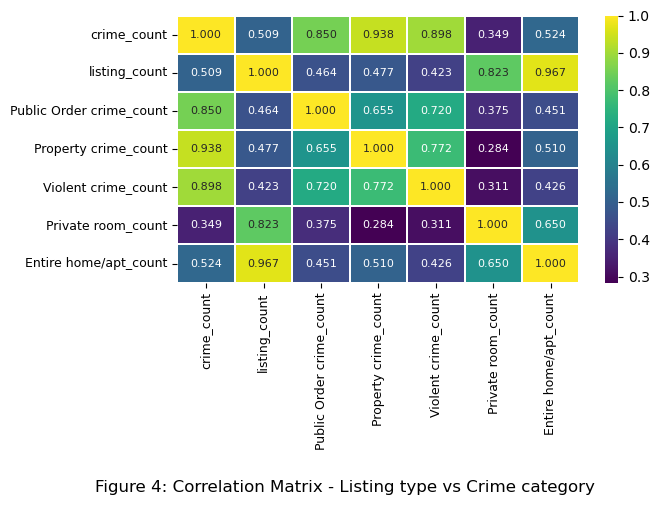

In [18]:
# Make the correlation matrix
cols = [col for col in lsoa_merge.columns if "count" in col]

lsoa_merge_sub1 = lsoa_merge[cols]
lsoa_merge_sub1_comatrix = lsoa_merge_sub1.corr()
# plot the correlation matrix plot
fig, axes = plt.subplots(figsize=(7, 5))
sns.heatmap(
    lsoa_merge_sub1_comatrix,
    cmap="viridis",
    annot=True,
    fmt=".3f",
    linewidths=0.1,
    annot_kws={"size": 8},
    ax=axes,
)
axes.tick_params(labelsize=9)

fig.suptitle(
    "Figure 4: Correlation Matrix - Listing type vs Crime category", x=0.5, y=-0.03
)
plt.tight_layout()
plt.show()

Beyond static correlation, when visualised on a map, more patterns emerge. Other notable areas outside of central London with a high concentration of crime incidents and Airbnb listings are **Hillington (Heathrow Airport), Richmond upon Thames, Croydon, Greenwich, Hounslow, etc.** Some are tourist destinations, while others, in contrast, seem to be in residential areas. This might allude to an underlying relationship between the concentration of Airbnb and crimes with tourism in general or population centres, and not between these variables alone. 

Based on descriptive statistics so far, we can draw certain mixed conclusions about the relationship between crime and short-let. On the one hand, the distribution of Airbnb listings does align with the distribution of crime in many areas. More notably, we find correlations between Entire home/apt and Property crime. On the other hand, an underlying factor might shape this relationship across space (spatial dependence, confounding variables such as tourism attractiveness, etc.) 

In [19]:
# Convert shapefile to geojson that the visualisation function requires
lsoa_merge_wgs = lsoa_merge.to_crs(4326)
lsoa_merge_wgs.to_file(os.path.join("data", "lsoa_merge.geojson"))
geojson = json.load(open(os.path.join("data", "lsoa_merge.geojson"), "r"))
# Iterate over JSON to add necessary 'id' property
for i in range(len(geojson["features"])):
    geojson["features"][i]["id"] = geojson["features"][i]["properties"]["LSOA21CD"]

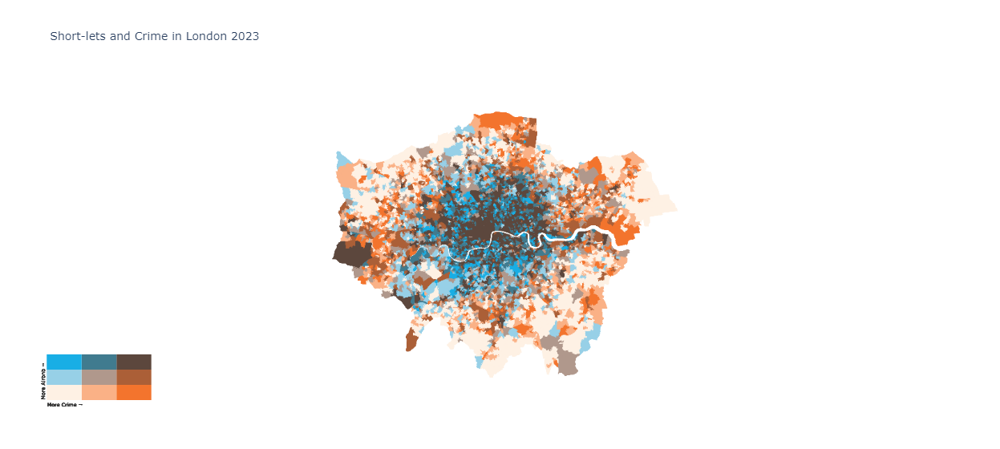

In [20]:
# Load conf defaults and override some variables for our London map
conf = conf_defaults()
conf["plot_title"] = "Short-lets and Crime in London 2023"
conf["hover_x_label"] = "Crime"  # Label to appear on hover
conf["hover_y_label"] = "AirBnb listings"  # Label to appear on hover
conf["width"] = 700
conf["center_lat"] = 51.508  # Latitude of the center of the map
conf["center_lon"] = -0.1  # Longitude of the center of the map
conf["map_zoom"] = 9  # Zoom factor of the map
conf["borders_width"] = 0  # Width of the geographic entity borders

# Define settings for the legend
conf["top"] = 0.1  # Vertical position of the top right corner (0: bottom, 1: top)
conf["right"] = 0.1  # Horizontal position of the top right corner (0: left, 1: right)
conf["line_width"] = 0  # Width of the rectangles' borders
conf["legend_x_label"] = "More Crime"  # x variable label for the legend
conf["legend_y_label"] = "More Airbnb"  # y variable label for the legend

# Plot
fig = create_bivariate_map(
    lsoa_merge,
    color_sets["blue-orange"],
    geojson,
    x="crime_count",
    y="listing_count",
    ids="LSOA21CD",
    name="LSOA21NM",
    conf=conf,
)
fig.show()

In [21]:
#| output: false
img = cache_data(
    "https://www.dropbox.com/scl/fi/e8epq7uc943zvjz2es6si/newplot-1.png?rlkey=rlgydu69vjzuxnuvch8ptu2y1&dl=1",
    ddir,
)

Found data/geo/newplot-1.png locally!


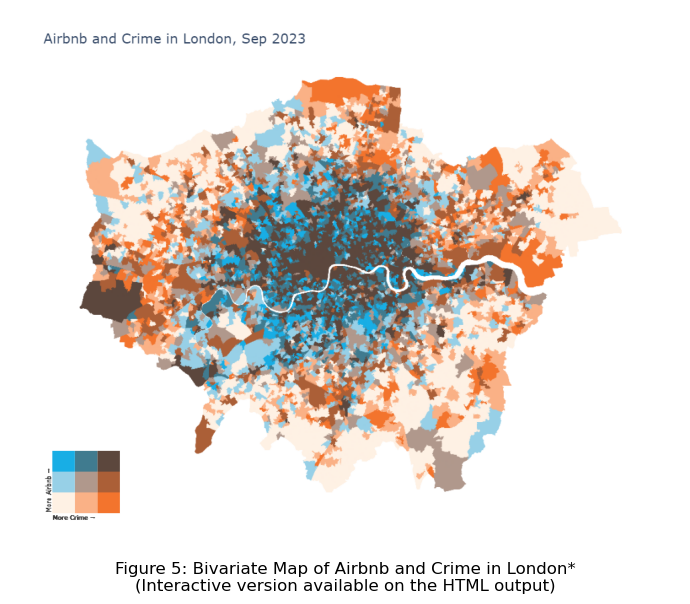

In [22]:
plt.figure(figsize=(7, 15))
plt.title(
    "Figure 5: Bivariate Map of Airbnb and Crime in London*\n(Interactive version available on the HTML output)",
    x=0.5,
    y=-0.1,
)
image = mpimg.imread(os.path.join(ddir, "newplot-1.png"))
plt.imshow(image)
plt.axis("off")
plt.tight_layout()
plt.show()

## 7. Shortlet vs Crime and Policy recommendations

#### Preparing Regression Data

We will perform a regression analysis to determine whether different shortlet types has an effect on crime overall and also different crime categories, controlling for other relevant sociodemographic variables as much as possible. These control variables directly or indirectly provide a level of deprivation, which serves as a significant socioeconomic indicator linked to crime patterns (*Crimes recorded by neighbourhood income deprivation decile in London*, 2022). 

The target dependent variables are :
- proportion of all crime, property crime, public order crime, and violent crime, over LSOA population

The target indendpendent variables (predictors) are:
- proportion of Private and Entire home listings over total household

The control independent variables are:
- population density,
- proportion of unemployed people among 16+
- proportion of young people (15-24 ages),
- proportion of household with a deprivation index of 3+
- proportion of people with qualification level 3 or higher
- proportion of tenanted household over all households

Since we are using a simple linear regression to model this relationship to test our hypothesis, we must make sure the variables satisfy basic distribution requirements. Therefore we performed log transformations for select variable. Figure 7 shows the variables post-transformation.

In [23]:
pcadf = lsoa_stat.loc[:,~lsoa_stat.columns.str.contains('all', case=False)]
pcadf = pcadf.set_index('LSOA code')

In [24]:
pcadf.drop(columns=pcadf.select_dtypes(['category','object']).columns.to_list(), inplace=True)

,Detached,Semi-detached,Terraced,Purpose built flat,Flat in a commercial building,Caravan / other mobile or temporary structure,Born in the UK,Aged 0 to 4,Aged 5 to 7,Aged 8 to 9,...,Shared ownership,Rented from Local Authority,Other social rented,Private landlord or letting agency,Other private rented,Rent free,Provides no care,1 to 19 hours,20 to 49 hours,50 or more hours
LSOA code,,,,,,,,,,,,,,,,,,,,,
E01000001,0,3,14,803,8,0,874,34,7,1,...,3,17,4,283,53,1,1322,69,17,15
E01000002,1,2,29,768,8,0,759,30,20,8,...,2,23,6,324,38,0,1258,75,9,8
E01000003,1,0,0,996,6,0,921,21,9,10,...,0,249,52,293,42,2,1471,63,18,22
E01000005,0,0,2,456,10,0,565,31,7,7,...,1,148,186,91,15,0,972,37,18,23
E01032739,2,7,17,608,96,0,697,40,11,4,...,3,3,8,555,97,0,1546,50,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
E01035718,11,30,173,358,11,1,1065,100,59,20,...,4,6,12,276,103,1,2388,55,18,11
E01035719,0,1,1,624,0,0,535,37,17,24,...,2,86,80,226,18,3,1150,44,13,12
E01035720,2,2,45,483,7,0,640,18,16,17,...,17,114,130,155,21,1,1118,38,17,11


In [25]:
# Robust Rescale

from sklearn.preprocessing import RobustScaler

rs = RobustScaler(quantile_range=(10.0, 90.0))

for c in pcadf.columns.values:
    pcadf[c] = rs.fit_transform(pcadf[c].values.reshape(-1, 1))

In [26]:
# Fit

from sklearn.decomposition import PCA 

pca = PCA(n_components=50, whiten=True) 

pca.fit(pcadf)

explained_variance = pca.explained_variance_ratio_
singular_values = pca.singular_values_

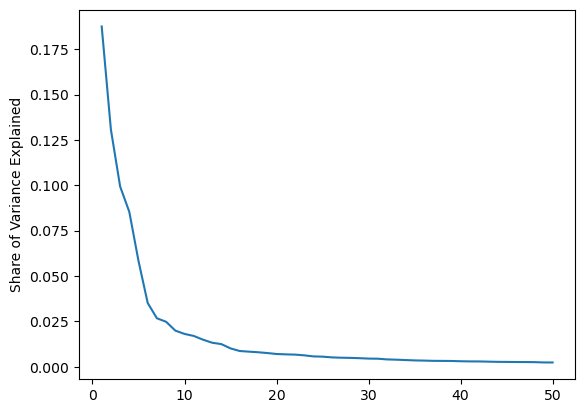

In [27]:
# Explained Variance

x = np.arange(1,len(explained_variance)+1)
plt.plot(x, explained_variance)
plt.ylabel('Share of Variance Explained')
plt.show()

In [28]:
cum_var = float()
for i in range(0, 20):
    cum_var += explained_variance[i]
    print(f"All components up to {i:>2} account for {cum_var*100:>2.2f}% of cumulative variance")

All components up to  0 account for 18.76% of cumulative variance
All components up to  1 account for 31.83% of cumulative variance
All components up to  2 account for 41.78% of cumulative variance
All components up to  3 account for 50.31% of cumulative variance
All components up to  4 account for 56.14% of cumulative variance
All components up to  5 account for 59.65% of cumulative variance
All components up to  6 account for 62.32% of cumulative variance
All components up to  7 account for 64.80% of cumulative variance
All components up to  8 account for 66.79% of cumulative variance
All components up to  9 account for 68.60% of cumulative variance
All components up to 10 account for 70.29% of cumulative variance
All components up to 11 account for 71.79% of cumulative variance
All components up to 12 account for 73.11% of cumulative variance
All components up to 13 account for 74.35% of cumulative variance
All components up to 14 account for 75.36% of cumulative variance
All compon

Knee detected at: 9


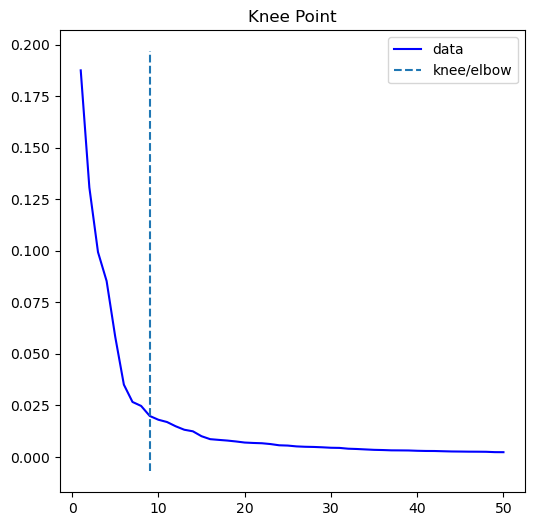

In [29]:
from kneed import knee_locator

kn = knee_locator.KneeLocator(x, explained_variance, 
                              curve='convex', direction='decreasing', 
                              interp_method='interp1d')
print(f"Knee detected at: {kn.knee}")
kn.plot_knee()

In [30]:
keep_n_components = 9

# If we weren't changing the number of components we
# could re-use the pca object created above. 
pca = PCA(n_components=keep_n_components, whiten=True)

X_train = pca.fit_transform(pcadf)

print(f"Total explained variance: {pca.explained_variance_ratio_.sum()*100:2.2f}%")
for i in range(0, keep_n_components):
    print(f"  Component {i:>2} accounts for {pca.explained_variance_ratio_[i]*100:>5.2f}% of variance")

# Notice...
print(f"X-train shape: {X_train.shape[0]}")
print(f"PCA df shape: {pcadf.shape[0]}")

Total explained variance: 66.79%
  Component  0 accounts for 18.76% of variance
  Component  1 accounts for 13.07% of variance
  Component  2 accounts for  9.94% of variance
  Component  3 accounts for  8.54% of variance
  Component  4 accounts for  5.83% of variance
  Component  5 accounts for  3.51% of variance
  Component  6 accounts for  2.67% of variance
  Component  7 accounts for  2.48% of variance
  Component  8 accounts for  1.99% of variance
X-train shape: 4994
PCA df shape: 4994


In [31]:
for i in range(0,keep_n_components):
    s = pd.Series(X_train[:,i], index=pcadf.index)
    pcadf[f"Component {i+1}"] = s

,Detached,Semi-detached,Terraced,Purpose built flat,Flat in a commercial building,Caravan / other mobile or temporary structure,Born in the UK,Aged 0 to 4,Aged 5 to 7,Aged 8 to 9,...,50 or more hours,Component 1,Component 2,Component 3,Component 4,Component 5,Component 6,Component 7,Component 8,Component 9
LSOA code,,,,,,,,,,,,,,,,,,,,,
E01000001,-0.258427,-0.303337,-0.371622,1.021016,0.153846,0.0,-0.267089,-0.363951,-0.515152,-0.652174,...,-0.500000,-1.406116,1.862109,-0.352258,0.084450,0.852202,0.632906,0.503862,1.813912,-1.129491
E01000002,-0.247191,-0.306707,-0.320946,0.959720,0.153846,0.0,-0.440622,-0.433276,-0.121212,-0.347826,...,-0.705882,-1.472908,1.980268,-0.432723,-0.275124,0.813424,0.312746,0.579994,1.676233,-1.526077
E01000003,-0.247191,-0.313448,-0.418919,1.359019,0.076923,0.0,-0.196167,-0.589255,-0.454545,-0.260870,...,-0.294118,-0.597304,2.309291,-0.453920,0.239158,-0.117142,1.559973,0.205946,1.982254,-1.356576
E01000005,-0.258427,-0.313448,-0.412162,0.413310,0.230769,0.0,-0.733364,-0.415945,-0.515152,-0.391304,...,-0.264706,-0.759947,0.288002,-0.542804,-2.605459,-0.310918,0.800805,1.256683,0.619351,0.030177
E01032739,-0.235955,-0.289855,-0.361486,0.679510,3.538462,0.0,-0.534178,-0.259965,-0.393939,-0.521739,...,-0.852941,-0.733738,3.155352,-0.724725,-0.259861,2.016857,-0.190538,0.536010,1.917466,-0.787945


In [57]:
pcadf[pcadf.columns[-9:]].head()

,Component 1,Component 2,Component 3,Component 4,Component 5,Component 6,Component 7,Component 8,Component 9
LSOA code,,,,,,,,,
E01000001,-1.406116,1.862109,-0.352258,0.084450,0.852202,0.632906,0.503862,1.813912,-1.129491
E01000002,-1.472908,1.980268,-0.432723,-0.275124,0.813424,0.312746,0.579994,1.676233,-1.526077
E01000003,-0.597304,2.309291,-0.453920,0.239158,-0.117142,1.559973,0.205946,1.982254,-1.356576
E01000005,-0.759947,0.288002,-0.542804,-2.605459,-0.310918,0.800805,1.256683,0.619351,0.030177
E01032739,-0.733738,3.155352,-0.724725,-0.259861,2.016857,-0.190538,0.536010,1.917466,-0.787945


In [70]:
# Merge selected columns from lsoa_stat_sel to lsoa_merge by LSOA21CD
lsoa_stat_sel = pcadf[pcadf.columns[-9:]].copy()
lsoa_stat_sel = lsoa_stat_sel.merge(
    lsoa_stat[[
        "LSOA code",
        "All Households",
        "All usual residents aged 16 or over",
        "All usual residents"
    ]],
    how='left',
    left_index=True,
    right_on="LSOA code",
).set_index("LSOA code")

lsoa_stat_sel

,Component 1,Component 2,Component 3,Component 4,Component 5,Component 6,Component 7,Component 8,Component 9,All Households,All usual residents aged 16 or over,All usual residents
LSOA code,,,,,,,,,,,,
E01000001,-1.406116,1.862109,-0.352258,0.084450,0.852202,0.632906,0.503862,1.813912,-1.129491,838,1356,1473
E01000002,-1.472908,1.980268,-0.432723,-0.275124,0.813424,0.312746,0.579994,1.676233,-1.526077,824,1301,1382
E01000003,-0.597304,2.309291,-0.453920,0.239158,-0.117142,1.559973,0.205946,1.982254,-1.356576,1015,1504,1613
E01000005,-0.759947,0.288002,-0.542804,-2.605459,-0.310918,0.800805,1.256683,0.619351,0.030177,474,964,1111
E01032739,-0.733738,3.155352,-0.724725,-0.259861,2.016857,-0.190538,0.536010,1.917466,-0.787945,881,1546,1607
...,...,...,...,...,...,...,...,...,...,...,...,...
E01035718,1.042666,1.933449,-0.147401,0.960376,3.973383,3.320370,4.252624,0.756008,-3.475936,732,2299,2573
E01035719,-0.889667,1.066455,-0.473017,-1.546600,0.446761,0.601199,-0.066325,1.464215,0.154084,630,1100,1274
E01035720,-0.869364,0.820929,-0.500755,-1.477342,0.019511,0.312331,0.055001,0.736218,-0.433468,588,1066,1218


In [71]:
lsoa_merge1 = lsoa_merge.merge(
    lsoa_stat_sel,
    how="left",
    left_on="LSOA21CD",
    right_index = True
    )
lsoa_merge1.columns

Index(['OBJECTID', 'LSOA21CD', 'LSOA21NM', 'GlobalID', 'geometry',
       'crime_count', 'listing_count', 'Public Order crime_count',
       'Property crime_count', 'Violent crime_count', 'Private room_count',
       'Entire home/apt_count', 'biv_bins', 'Component 1', 'Component 2',
       'Component 3', 'Component 4', 'Component 5', 'Component 6',
       'Component 7', 'Component 8', 'Component 9', 'All Households',
       'All usual residents aged 16 or over', 'All usual residents'],
      dtype='object')

Index(['OBJECTID', 'LSOA21CD', 'LSOA21NM', 'GlobalID', 'geometry',
       'crime_count', 'listing_count', 'Public Order crime_count',
       'Property crime_count', 'Violent crime_count', 'Private room_count',
       'Entire home/apt_count', 'Component 1', 'Component 2', 'Component 3',
       'Component 4', 'Component 5', 'Component 6', 'Component 7',
       'Component 8', 'Component 9', 'All Households',
       'All usual residents aged 16 or over', 'All usual residents'],
      dtype='object')

In [81]:
# Add density for each column in lsoa_merge1 nased on All Households and All usual residents

# Select columns and calculate density
lsoa_merge1["crime_density"] = (
    lsoa_merge1["crime_count"] / lsoa_merge1["All usual residents"]
)
lsoa_merge1["listing_density"] = (
    lsoa_merge1["listing_count"] / lsoa_merge1["All Households"]
)
lsoa_merge1["Private room_density"] = (
    lsoa_merge1["Private room_count"] / lsoa_merge1["All Households"]
)
lsoa_merge1["Entire home/apt_density"] = (
    lsoa_merge1["Entire home/apt_count"] / lsoa_merge1["All Households"]
)
lsoa_merge1["Public Order crime_density"] = (
    lsoa_merge1["Public Order crime_count"] / lsoa_merge1["All usual residents"]
)
lsoa_merge1["Property crime_density"] = (
    lsoa_merge1["Property crime_count"] / lsoa_merge1["All usual residents"]
)
lsoa_merge1["Violent crime_density"] = (
    lsoa_merge1["Violent crime_count"] / lsoa_merge1["All usual residents"]
)
lsoa_merge1["area"] = lsoa_merge1["geometry"].area
lsoa_merge1["pop_density"] = lsoa_merge1["All usual residents"] / lsoa_merge1["area"]



regressiondata = lsoa_merge1.copy()
regressiondata = regressiondata.set_index('LSOA21CD')

# Keep ones needed for regression
regressiondata = regressiondata.loc[
    :, [col for col in regressiondata.columns if "All" not in col]
]

regressiondata = regressiondata.loc[
    :, [col for col in regressiondata.columns if "count" not in col]
]

for col in ['biv_bin','OBJECTID','LSOA21NM','GlobalID','geometry','area','pop_density']:
    try:
        regressiondata = regressiondata.drop(columns=col)
    except:
        pass

regressiondata.columns

Index(['Component 1', 'Component 2', 'Component 3', 'Component 4',
       'Component 5', 'Component 6', 'Component 7', 'Component 8',
       'Component 9', 'crime_density', 'listing_density',
       'Private room_density', 'Entire home/apt_density',
       'Public Order crime_density', 'Property crime_density',
       'Violent crime_density'],
      dtype='object')

In [37]:
# Function to approximate what a normal distribution would be from a dataset
# Adapted from CASA0013
def normal_from_dist(
    series,
):  # define function name and required arguments (in this case a pandas series)
    mu = series.mean()  # calculate the mean of our data
    sd = series.std()  # calculate the standard deviation of our data
    n = len(series)  # count how many observations are in our data
    s = np.random.normal(
        mu, sd, n
    )  # use the parameters of the data just calculated to generate n random numbers, drawn from a normal distributions
    return s  # return this set of random numbers

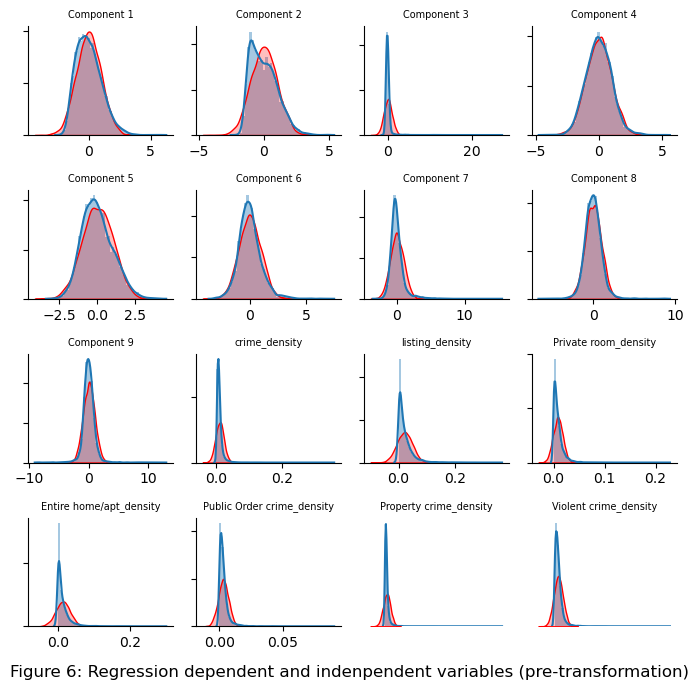

In [77]:
test_cols_df = regressiondata.copy()

fig, axes = plt.subplots(4,4, figsize=(7, 7))
axflat = axes.flatten()
for i, ax in enumerate(axflat):
    sns.distplot(test_cols_df.iloc[:,i], ax=ax)
    sns.kdeplot(normal_from_dist(test_cols_df.iloc[:,i]), color='r', fill=True, ax=ax)
    ax.set_title(test_cols_df.columns[i],fontsize=7)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_yticklabels('')
    sns.despine()
for ax in axflat[-2:]:
    ax.axis('off')
fig.suptitle('Figure 6: Regression dependent and indenpendent variables (pre-transformation)',x=0.5,y=0)
plt.tight_layout()
plt.show()

In [83]:
# Log of the variables social rent, private room, entire home/apt, pop_density, etc.
cols = [
    "Private room_density",
    "Entire home/apt_density",
    "listing_density",
    "crime_density",
    "Public Order crime_density",
    "Property crime_density",
    "Violent crime_density",
]
for col in cols:
    # remove rows (LSOAs) with no airbnbs
    c = regressiondata[col].sort_values().unique()[1]
    regressiondata[col + "_log"] = np.log(regressiondata[col] + c)
# Drop original columns
regressiondata.drop(cols, axis=1, inplace=True)

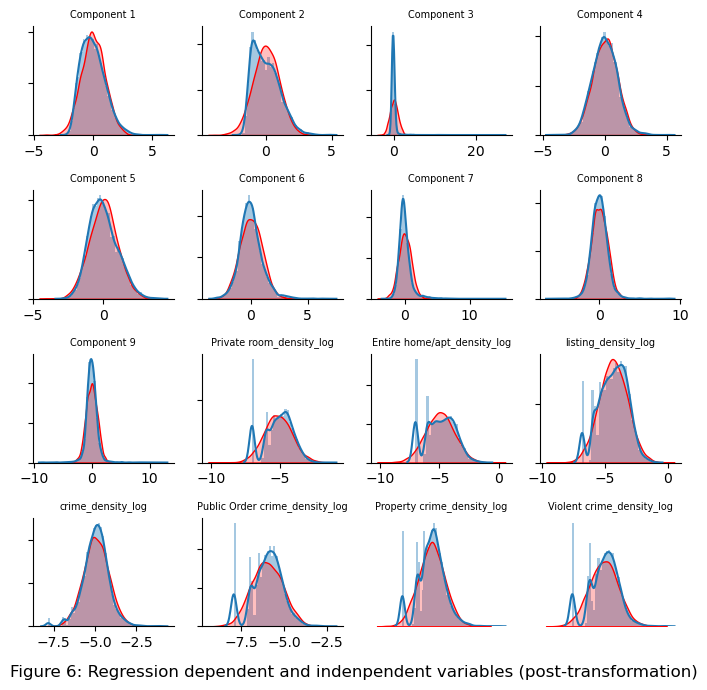

In [79]:
test_cols_df = regressiondata.copy()

fig, axes = plt.subplots(4,4, figsize=(7, 7))
axflat = axes.flatten()
for i, ax in enumerate(axflat):
    sns.distplot(test_cols_df.iloc[:,i], ax=ax)
    sns.kdeplot(normal_from_dist(test_cols_df.iloc[:,i]), color='r', fill=True, ax=ax)
    ax.set_title(test_cols_df.columns[i],fontsize=7)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_yticklabels('')
    sns.despine()
for ax in axflat[-2:]:
    ax.axis('off')
fig.suptitle('Figure 6: Regression dependent and indenpendent variables (post-transformation)',x=0.5,y=0)
plt.tight_layout()
plt.show()

In [84]:
regressiondata.columns

Index(['Component 1', 'Component 2', 'Component 3', 'Component 4',
       'Component 5', 'Component 6', 'Component 7', 'Component 8',
       'Component 9', 'Private room_density_log',
       'Entire home/apt_density_log', 'listing_density_log',
       'crime_density_log', 'Public Order crime_density_log',
       'Property crime_density_log', 'Violent crime_density_log'],
      dtype='object')

In [85]:
#| output: false

# drop crime related columns to check for multicollinearity
regressiondata_VIF = regressiondata.drop(
    [col for col in regressiondata.columns if "crime" in col], axis=1
)
# drop columns with high VIF
regressiondata_VIF = drop_column_using_vif_(regressiondata_VIF)
selected_cols = regressiondata_VIF.columns.tolist()

Dropping: listing_density_log


#### Regression Results

We found some key predictor variables to be statistically significant, most notably within our target variables (All Regression Results can be found in the Appendix):

- **Entire home/apt** has a notable effect on property crime incidents, followed by public order crime and, finally, violent crime.
- Meanwhile, **Private room** interestingly only has a notable and significant effect on public order crime and violent crime. 

In [86]:
models = []
results = []
for i in ["crime_", "Property crime_", "Violent crime_", "Public Order crime_"]:
    # OLS model
    OLS = sm.OLS(
        endog=regressiondata[i + "density_log"],
        exog=sm.add_constant(regressiondata[selected_cols]),
    )
    OLSmodel = OLS.fit()
    models.append(OLS)
    results.append(OLSmodel)
    print(OLSmodel.summary())
    print('='* 98)
    print('\n')

                            OLS Regression Results                            
Dep. Variable:      crime_density_log   R-squared:                       0.277
Model:                            OLS   Adj. R-squared:                  0.276
Method:                 Least Squares   F-statistic:                     173.7
Date:                Sun, 14 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:41:06   Log-Likelihood:                -4984.7
No. Observations:                4994   AIC:                             9993.
Df Residuals:                    4982   BIC:                         1.007e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

Before we can confirm our hypothesis that there is an impact of increased short-let presence on different types of crime, we will need to first consider the fact that the crime observed in an LSOA affects crime observed in the neighbouring LSOAs results in spatial autocorrelation among the residuals. In fact, Moran's I test stats in Figure 7 show that, as a whole, there is only a slight spatial autocorrelation among the residuals (Coeffs close to 0). Areas where our model might under-predict crime are in red (HH), whereas areas where our model might over-predict crime are in blue (LL). 

Fortunately, the Spatial Error Model, which introduced a spatial component into our original OLS model for All Crimes (see in Appendix), shows that it does not significantly affect the coefficients of our target variables. More specifically:

- **Private room** has a slightly stronger effect when spatial errors are added. (coeff=0.043 vs 0.040)
- **Entire home/apt** has a slightly weaker effect when spatial errors are added. (coeff=0.1473 vs 0.1645)

With this, we can conclude that there is a positive effect of the density of Airbnb listings on crime in a neighbourhood, especially for Entire home/apt listings.

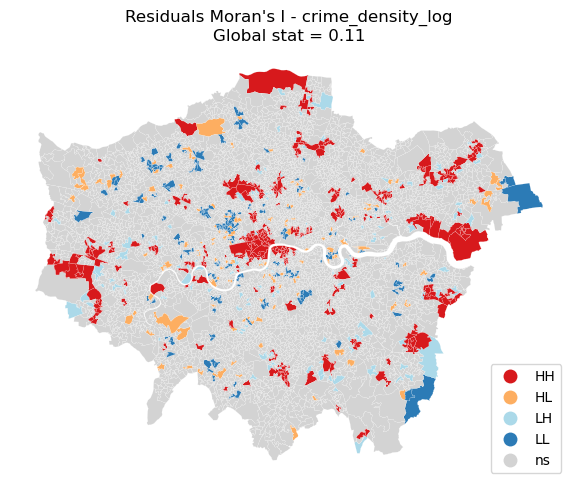

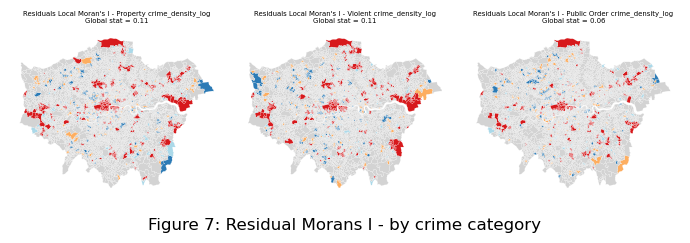

In [45]:
# Local Moran's I for residual of OLSmodel

# Create spatial weights matrix
w = Queen.from_dataframe(lsoa)
w.transform = "r"

residuals = results[0].resid
moran = Moran(residuals, w)
moran_loc = Moran_Local(residuals, w)
lisa_cluster(
    moran_loc, lsoa, p=0.05, figsize=(7, 5), legend_kwds={"loc": "lower right"}
)
plt.title(f"Residuals Moran's I - {models[0].endog_names}\nGlobal stat = {moran.I:.2f}")
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 3, figsize=(7, 3))
ax = axes.flatten()
for i in range(3):
    residuals = results[i].resid
    moran = Moran(residuals, w)
    moran_loc = Moran_Local(residuals, w)
    lisa_cluster(moran_loc, lsoa, p=0.05, ax=ax[i], legend=False)
    ax[i].set_title(
        f"Residuals Local Moran's I - {models[i+1].endog_names}\nGlobal stat = {moran.I:.2f}",
        fontsize=5,
    )

fig.suptitle("Figure 7: Residual Morans I - by crime category", x=0.5, y=0.1)
plt.tight_layout()
plt.show()

#### Do short-lets in different areas have a different effect on crime?

Using a Geographically Weighted Regression, we can further visualise where precisely the effect of short lets on crime is statistically significant. The results show that:

- **Private Room** presence has a particularly strong effect on crime (including property crime) in East and Southeast London (City, Boroughs of Tower Hamlets, Bermondsey, Southwark, etc.)
- **Entire Home** presence has a particularly strong effect on crime (including Property Crime) in Central London (Boroughs of Westminster, Camden, South Islington)

In [53]:
# Prepare dataset inputs - Crime
g_y = regressiondata["crime_density_log"].values.reshape((-1, 1))
g_X = regressiondata[selected_cols].values
lsoa_cen = lsoa.centroid.get_coordinates()
u = lsoa_cen["x"]
v = lsoa_cen["y"]
g_coords = list(zip(u, v))

g_X = (g_X - g_X.mean(axis=0)) / g_X.std(axis=0)
g_y = (g_y - g_y.mean(axis=0)) / g_y.std(axis=0)

# Calibrate GWR model
# gwr_selector = Sel_BW(g_coords, g_y, g_X)
# gwr_bw = gwr_selector.search(bw_min=2)
# print(gwr_bw)
gwr_bw = 504  # I calibrated this
gwr_results = GWR(g_coords, g_y, g_X, gwr_bw).fit()

# Add Paramaters back to geo dataframe for mapping
lsoa["gwr_intercept"] = gwr_results.params[:, 0]
for i in range(len(selected_cols)):
    lsoa["gwr_" + selected_cols[i]] = gwr_results.params[:, i + 1]

# Filter Insignificant coefficients alpha 0.05
gwr_filtered_t = gwr_results.filter_tvals(alpha=0.05)

In [55]:
# Prepare dataset inputs - Property Crime
g_y1 = regressiondata["Property crime_density_log"].values.reshape((-1, 1))
g_X = regressiondata[selected_cols].values
lsoa_cen = lsoa.centroid.get_coordinates()
u = lsoa_cen["x"]
v = lsoa_cen["y"]
g_coords = list(zip(u, v))

g_X = (g_X - g_X.mean(axis=0)) / g_X.std(axis=0)
g_y1 = (g_y1 - g_y1.mean(axis=0)) / g_y1.std(axis=0)

# Calibrate GWR model
# gwr_selector1 = Sel_BW(g_coords, g_y1, g_X)
# gwr_bw1 = gwr_selector1.search(bw_min=2)
# print(gwr_bw1)
gwr_bw1 = 560  # I calibrated this
gwr_results1 = GWR(g_coords, g_y1, g_X, gwr_bw1).fit()

# Add Paramaters back to geo dataframe for mapping
lsoa["gwr_intercept_prop_"] = gwr_results1.params[:, 0]
for i in range(len(selected_cols)):
    lsoa["gwr_prop_" + selected_cols[i]] = gwr_results1.params[:, i + 1]
    
# Filter Insignificant coefficients alpha 0.05
gwr_prop_filtered_t = gwr_results1.filter_tvals(alpha=0.05)

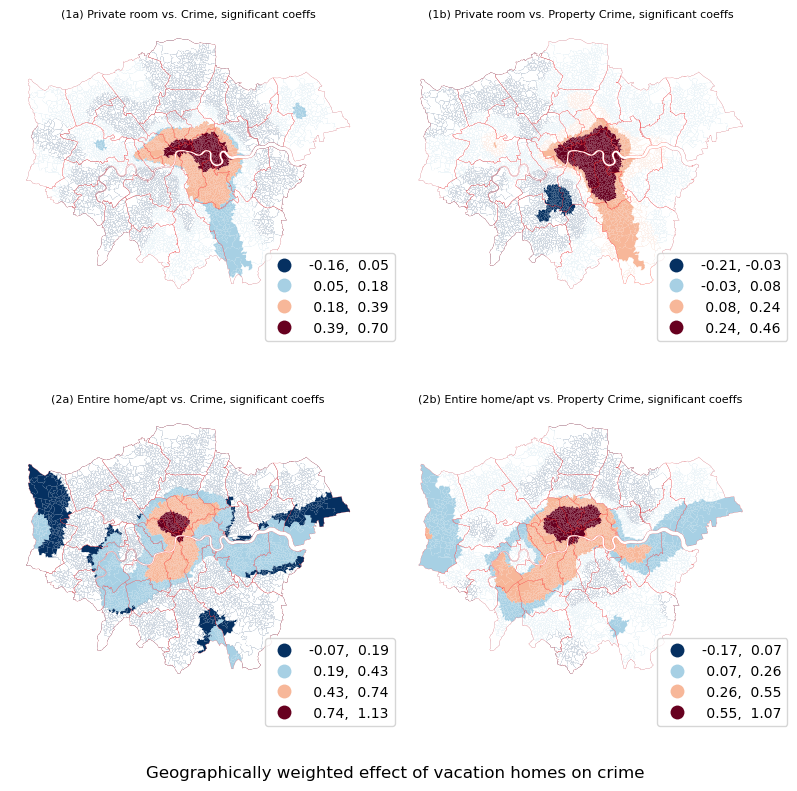

In [56]:
# Map them both, sig coeff only
# Adapted from https://deepnote.com/@carlos-mendez/PYTHON-GWR-and-MGWR-71dd8ba9-a3ea-4d28-9b20-41cc8a282b7a
import matplotlib.colors as mcolors

type = ["Private room", "Entire home/apt"]
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))
for i in range(len(type)):
    # All crime
    lsoa.plot(
        column=f"gwr_{type[i]}_density_log",
        cmap="RdBu_r",
        linewidth=0.001,
        scheme="naturalbreaks",
        k=4,
        legend=True,
        legend_kwds={"bbox_to_anchor": (1.10, 0.2)},
        ax=axes[i, 0],
    )
    lsoa[gwr_filtered_t[:, i + 10] == 0].plot(
        color="white", linewidth=0.001, edgecolor="white", ax=axes[i, 0]
    )  # 10th variables in variable array
    boros.plot(edgecolor="red", facecolor="None", linewidth=0.1, ax=axes[i, 0])

    # Property crime
    lsoa.plot(
        column=f"gwr_prop_{type[i]}_density_log",
        cmap="RdBu_r",
        linewidth=0.001,
        scheme="naturalbreaks",
        k=4,
        legend=True,
        legend_kwds={"bbox_to_anchor": (1.10, 0.2)},
        ax=axes[i, 1],
    )
    lsoa[gwr_prop_filtered_t[:, i + 10] == 0].plot(
        color="white", linewidth=0.001, edgecolor="white", ax=axes[i, 1]
    )  # 10th variables in variable array
    boros.plot(edgecolor="red", facecolor="None", linewidth=0.1, ax=axes[i, 1])

    axes[i, 0].axis("off")
    axes[i, 1].axis("off")
    axes[i, 0].set_title(
        f"({i+1}a) {type[i]} vs. Crime, significant coeffs", fontsize=8
    )
    axes[i, 1].set_title(
        f"({i+1}b) {type[i]} vs. Property Crime, significant coeffs", fontsize=8
    )
plt.tight_layout()
fig.suptitle(
    "Geographically weighted effect of vacation homes on crime", x=0.5, y=0
)
plt.show()

#### Reflection and Recommendations
After the public consultation on the policy in 2022, the government will require landlords to register and will conduct random checks on some listings or require landlords to upload legal documents to prove the safety of their listings (Consultation on a registration scheme for short-term lets in England, 2023). While this will allow for better listing management and tenants' safety, we recommend further actions based on our analysis thus far:

First, for **property crime**, *entire home* shortlets are at particular risk, especially in central London, and *private room* listings in East London, whether shortlet tenants are committing theft or disturbances against neighbours or being targeted. We suggest that Airbnb should strengthen the background checks of tenants (Barron, Kung, and Proserpio, 2018) and choose whether to ban the use of the Airbnb platform according to the number of tenants with criminal property records. If permitted, Airbnb needs to provide relevant information to the landlord and keep records synchronised with local police departments. In the property security protection of tenants, Airbnb needs to strengthen the door lock management, such as encouraging the landlord to replace the smart door lock as much as possible and allowing each group of tenants to reset their password.

Second, there is an impact of shortlets on **violent crime and public order crime**. Since our crime data cannot be detailed into whether or not the offence occurred within the listing, the following recommendations will encompass all stakeholders:

* **a) For Airbnb**, more regulations on tenants' behaviour are needed. For example, while Airbnb currently states the required quiet time for tenants on its booking interface, it does not specify penalties. For tenants reported for taking drugs, disturbing residents, committing crimes against neighbours or listings, or violating Airbnb’s rules, Airbnb shall block the tenant’s Airbnb account based on the severity. Moreover, Airbnb should set up efficient channels to ensure responsive security measures, making it easier for tenants or landlords to file complaints against each other. Especially after receiving safety reports about the listings, Airbnb should consider taking the listings offline (Grind and Shifflett, 2019). 
* **b) For the government**, there are benefits to strictly regulating shortlets, e.g. enforcing owner-occupied residences, a cap on the number of renters, and neighbour notifications (Vande Bunte, 2014). Moreover, we could refer to San Francisco’s approach, which imposes strict rules on the duration each landlord can rent out a property each year, effectively controlling the number of short-rental properties (Cromarty, 2023), reducing the transient population (Mburu and Helbich, 2016). Besides, a conscious effort should be made to increase police presence in places where Airbnb is particularly dense. 
* **c) For tenants**, both Airbnb and the government should encourage them to understand and comply with local laws and regulations regarding short-term rentals like the New York State Multiple Dwelling Law (Schneiderman, 2014) through various channels, such as news pop-ups and educational publicity programs. Improving public awareness is essential to reducing crime and creating a safe environment (Lemieux and Felson, 2019).

## Appendix:

#### 1. OLS Regression Results

--------------------------------------------

OLS Regression results for each of the four dependent variables:

In [87]:
# Regression Results

for i in results:
    print(i.summary())
    print("\n")

                            OLS Regression Results                            
Dep. Variable:      crime_density_log   R-squared:                       0.277
Model:                            OLS   Adj. R-squared:                  0.276
Method:                 Least Squares   F-statistic:                     173.7
Date:                Sun, 14 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:41:23   Log-Likelihood:                -4984.7
No. Observations:                4994   AIC:                             9993.
Df Residuals:                    4982   BIC:                         1.007e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

*Note:* our log transformation has greatly treated the Heteroscedasticity of the variables, although some do remain without greatly affecting the OLS regression results.

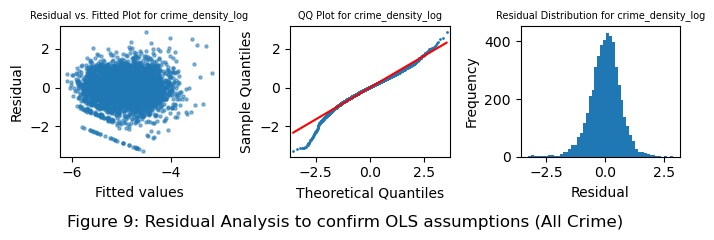

In [88]:
# Residuals vs. Fitted plot (All Crime model)
fig, axes = plt.subplots(1, 3, figsize=(7, 2.5))
# Plot the residuals vs fitted values on ax1
axes[0].scatter(results[0].fittedvalues, results[0].resid, alpha=0.5, s=5)
axes[0].set_xlabel(f"Fitted values")
axes[0].set_ylabel("Residual")
axes[0].set_title(f"Residual vs. Fitted Plot for {models[0].endog_names}", fontsize=7)

# QQplot on ax2
sm.qqplot(results[0].resid, line="s", markersize=1, ax=axes[1])
axes[1].set_title(f"QQ Plot for {models[0].endog_names}", fontsize=7)

# Residual distribution on ax3
axes[2].hist(results[0].resid, bins=50)
axes[2].set_xlabel("Residual")
axes[2].set_ylabel("Frequency")
axes[2].set_title(f"Residual Distribution for {models[0].endog_names}", fontsize=7)

fig.suptitle(
    "Figure 9: Residual Analysis to confirm OLS assumptions (All Crime)", x=0.5, y=0
)
plt.tight_layout()
plt.show()

#### 2. Spatial Error Model Results

In [89]:
# Spatial Error Model to deal with spatial autocorrelation

X = regressiondata[selected_cols].to_numpy()
y = regressiondata["crime_density_log"].to_numpy()

# Create a Queen spatial weights matrix
w = Queen.from_dataframe(lsoa)
w.transform = "r"

mod1 = GM_Error_Het(
    y=y,
    x=X,
    w=w,
    name_y="crime_density_log",
    name_x=regressiondata[selected_cols].columns.tolist(),
)
print(mod1.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED LEAST SQUARES (HET)
---------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :crime_density_log                Number of Observations:        4994
Mean dependent var  :     -4.9364                Number of Variables   :          12
S.D. dependent var  :      0.7723                Degrees of Freedom    :        4982
Pseudo R-squared    :      0.2760
N. of iterations    :           1                Step1c computed       :          No

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT      -4.1097160       0.0857875     -47.9057910       0.0000000
         Component 1       0.2015490       0.0108656      18.5493371      

## References

*About Inside Airbnb* (nd) Available at: http://insideairbnb.com/about/ (Accessed: 5 December 2023).

Barron, K., Kung, E. and Proserpio, D. (2018) * The Sharing Economy and Housing
Affordability: Evidence from Airbnb*. Available at: https://static1.squarespace.com/static/5bb2d447a9ab951efbf6d10a/t/5bea6881562fa7934045a3f0/1542088837594/The+Sharing+Economy+and+Housing+Affordability.pdf (Accessed: 14 December 2023).

*Consultation on a registration scheme for short-term lets in England* (2023) Available at: https://www.gov.uk/government/consultations/consultation-on-a-registration-scheme-for-short-term-lets-in-england/consultation-on-a-registration-scheme-for-short-term-lets-in-england (Accessed: 5 December 2023).

Cox, M. and Slee, T. (2016) *How Airbnb’s data hid the facts in New York City*. Available at: http://insideairbnb.com/research/how-airbnb-hid-the-facts-in-nyc (Accessed: 14 December 2023).

*Crime and income deprivation* (nd) Available at: https://trustforlondon.org.uk/data/crime-and-income-deprivation/#:~:text=Overall%2C%2052%25%20more%20crimes%20were,the%20least%20income%2Ddeprived%2010%25 (Accessed: 14 December 2023).

Cromarty, H. (2023) *The growth in short-term lettings (England)*. Available at: https://researchbriefings.files.parliament.uk/documents/CBP-8395/CBP-8395.pdf (Accessed: 18 December 2023).

D’Ignazio, C. and Klein, L.F. (2020) *The Numbers Don’t Speak for Themselves’*. United States: MIT Libraries Experimental Collections Fund.

Flatley, J. (2016) *Focus on property crime: year ending March 2016*. Available at: https://www.ons.gov.uk/peoplepopulationandcommunity/crimeandjustice/bulletins/focusonpropertycrime/yearendingmarch2016 (Accessed: 14 December 2023).

Grind, K. and Shifflett, S. (2019) ‘Shooting, Sex Crime and Theft: Airbnb Takes Halting Steps to Protect Its Users’, *The Wall Street Journal*. (Accessed: 17 December 2023).

*Inside Airbnb Data Dictionary* (nd) Available at: https://docs.google.com/spreadsheets/d/1iWCNJcSutYqpULSQHlNyGInUvHg2BoUGoNRIGa6Szc4/edit?usp=sharing (Accessed: 17 December 2023).

Lemieux, A.M. and Felson, M. (2019) ‘Tourist and Visitor Crime’, in Natarajan, M. (ed.) *International and Transnational Crime and Justice*. Cambridge University Press.

Mburu, L.W. and Helbich, M. (2016) ‘Crime Risk Estimation with a Commuter-Harmonized Ambient Population’, *Annals of the American Association of Geographers*, 106(4), pp. 804-818.

Schneiderman, E. (2014) *Airbnb in the city. New York State Office of the Attorney General*. Available at: http://www.ag.ny.gov/pdfs/Airbnbreport.pdf (Accessed 14 December 2023).

Vande Bunte, M. (2014) *Airbnb verdict in Grand Rapids: 1 room and 2 adults, with a possible exception*. Available at: https://www.mlive.com/news/grand-rapids/2014/08/airbnb_verdict_in_grand_rapids.html (Accessed: 17 December 2023).

Xu, Y.H., Kim, J. and Pennington-Gray, L. (2019) ‘The Sharing Economy: A Geographically Weighted Regression Approach to Examine Crime and the Shared Lodging Sector’, *Journal of Travel Research*, 58(7), pp. 1193-1208. Available at: https://journals.sagepub.com/doi/10.1177/0047287518797197 (Accessed: 17 December 2023).

Occasional use of Github Copilot AI within Visual Studio Code IDE

In [ ]:
# # Prepare dataset inputs - Crime
# g_y = regressiondata["crime_density"].values.reshape((-1, 1))
# g_X = regressiondata[selected_cols].values
# lsoa_cen = lsoa.centroid.get_coordinates()
# u = lsoa_cen["x"]
# v = lsoa_cen["y"]
# g_coords = list(zip(u, v))

# g_X = (g_X - g_X.mean(axis=0)) / g_X.std(axis=0)
# g_y = (g_y - g_y.mean(axis=0)) / g_y.std(axis=0)

# # Calibrate GWR model
# # gwr_selector = Sel_BW(g_coords, g_y, g_X)
# # gwr_bw = gwr_selector.search(bw_min=2)
# # print(gwr_bw)
# gwr_bw = 522  # I calibrated this
# gwr_results = GWR(g_coords, g_y, g_X, gwr_bw).fit()

# # Add Paramaters back to geo dataframe for mapping
# lsoa["gwr_intercept"] = gwr_results.params[:, 0]
# for i in range(len(selected_cols) - 1):
#     lsoa["gwr_" + selected_cols[i]] = gwr_results.params[:, i + 1]

# # Filter Insignificant coefficients alpha 0.05
# gwr_filtered_t = gwr_results.filter_tvals(alpha=0.05)

In [ ]:
# # Prepare dataset inputs - Property Crime
# g_y1 = regressiondata["Property crime_density"].values.reshape((-1, 1))
# g_X = regressiondata[selected_cols].values
# lsoa_cen = lsoa.centroid.get_coordinates()
# u = lsoa_cen["x"]
# v = lsoa_cen["y"]
# g_coords = list(zip(u, v))

# g_X = (g_X - g_X.mean(axis=0)) / g_X.std(axis=0)
# g_y1 = (g_y1 - g_y1.mean(axis=0)) / g_y1.std(axis=0)

# # Calibrate GWR model
# # gwr_selector1 = Sel_BW(g_coords, g_y1, g_X)
# # gwr_bw1 = gwr_selector1.search(bw_min=2)
# # print(gwr_bw1)
# gwr_bw1 = 560  # I calibrated this
# gwr_results1 = GWR(g_coords, g_y1, g_X, gwr_bw1).fit()

# # Add Paramaters back to geo dataframe for mapping
# lsoa["gwr_intercept_prop_"] = gwr_results1.params[:, 0]
# for i in range(len(selected_cols) - 1):
#     lsoa["gwr_prop_" + selected_cols[i]] = gwr_results1.params[:, i + 1]

# # Filter Insignificant coefficients alpha 0.05
# gwr_prop_filtered_t = gwr_results1.filter_tvals(alpha=0.05)

In [ ]:
# # Map them both, sig coeff only
# # Adapted from https://deepnote.com/@carlos-mendez/PYTHON-GWR-and-MGWR-71dd8ba9-a3ea-4d28-9b20-41cc8a282b7a

# type = ["Private room", "Entire home/apt"]
# fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(8, 8))
# for i in range(len(type)):
#     # All crime
#     lsoa.plot(
#         column=f"gwr_{type[i]}_density",
#         cmap="coolwarm",
#         linewidth=0.001,
#         scheme="naturalbreaks",
#         k=5,
#         legend=True,
#         legend_kwds={"bbox_to_anchor": (1.10, 0.2)},
#         ax=axes[i, 0],
#     )
#     lsoa[gwr_filtered_t[:, i + 6] == 0].plot(
#         color="white", linewidth=0.001, edgecolor="white", ax=axes[i, 0]
#     )  # 6th variables in variable array
#     boros.plot(edgecolor="red", facecolor="None", linewidth=0.1, ax=axes[i, 0])

#     # Property crime
#     lsoa.plot(
#         column=f"gwr_prop_{type[i]}_density",
#         cmap="coolwarm",
#         linewidth=0.001,
#         scheme="naturalbreaks",
#         k=5,
#         legend=True,
#         legend_kwds={"bbox_to_anchor": (1.10, 0.2)},
#         ax=axes[i, 1],
#     )
#     lsoa[gwr_prop_filtered_t[:, i + 6] == 0].plot(
#         color="white", linewidth=0.001, edgecolor="white", ax=axes[i, 1]
#     )  # 6th variables in variable array
#     boros.plot(edgecolor="red", facecolor="None", linewidth=0.1, ax=axes[i, 1])

#     axes[i, 0].axis("off")
#     axes[i, 1].axis("off")
#     axes[i, 0].set_title(
#         f"({i+1}a) {type[i]} vs. Crime, significant coeffs", fontsize=8
#     )
#     axes[i, 1].set_title(
#         f"({i+1}b) {type[i]} vs. Property Crime, significant coeffs", fontsize=8
#     )
# plt.tight_layout()
# fig.suptitle(
#     "Figure 8: Geographically weighted effect of short-lets on crime", x=0.5, y=0
# )
# plt.show()